# Visualize ResNet-34's features for different Losses

We will compare the features for models trained with different losses, so let's start by simply visualizing the attentions of a pre-trained model (ImageNet), as well as two that have been successfully trained with data from CARLA using L1 and Quantile (80-percentile) losses.

In [22]:
# Load the network

import warnings
warnings.simplefilter(action='ignore', category=FutureWarning)

from network.models.architectures.CIL_multiview.CIL_multiview import CIL_multiview
import os
import json
from configs import g_conf, set_type_of_process, merge_with_yaml

os.environ["CUDA_VISIBLE_DEVICES"] = "5"

exp_batch = 'CILv2_attention'
exp_name = 'CILv2_3cam_Town01_8hdata_AttentionLossKL_AreaDownsampling_notBinarized'

In [23]:
merge_with_yaml(os.path.join('configs', exp_batch, f'{exp_name}.yaml'))
g_conf.PROCESS_NAME = 'train_val'
g_conf.DATASET_PATH = '/datafast/Datasets/dporres/CARLA'

os.environ['DATASET_PATH'] = g_conf.DATASET_PATH

model = CIL_multiview(g_conf.MODEL_CONFIGURATION)

In [24]:
model

CIL_multiview(
  (encoder_embedding_perception): ResNet(
    (conv1): Conv2d(3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False)
    (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (relu): ReLU(inplace=True)
    (maxpool): MaxPool2d(kernel_size=3, stride=2, padding=1, dilation=1, ceil_mode=False)
    (layer1): Sequential(
      (0): BasicBlock(
        (conv1): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
        (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
        (relu): ReLU(inplace=True)
        (conv2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
        (bn2): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      )
      (1): BasicBlock(
        (conv1): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
        (bn1): BatchNorm2d(64, eps=1e-05, momentum=

In [25]:
# Load the checkpoint

from _utils.training_utils import check_saved_checkpoints

latest_checkpoint = check_saved_checkpoints(
    os.path.join('/datafast/experiments/dporres/VisionTFM/',
                 '_results', g_conf.EXPERIMENT_BATCH_NAME, g_conf.EXPERIMENT_NAME, 'checkpoints'))

In [26]:
latest_checkpoint

'/datafast/experiments/dporres/VisionTFM/_results/CILv2_attention/CILv2_3cam_Town01_8hdata_AttentionLossKL_AreaDownsampling_notBinarized/checkpoints/CIL_multiview_80.pth'

In [27]:
import torch

checkpoint = torch.load(latest_checkpoint)

checkpoint['model']

OrderedDict([('_model.positional_encoding',
              tensor([[[-7.6245e-02,  1.5341e-01, -2.5514e-02,  ..., -3.4917e-02,
                        -5.3685e-02,  1.2090e-01],
                       [-4.4181e-02,  9.5538e-02, -1.4743e-02,  ..., -1.0923e-02,
                        -3.1101e-02,  7.6292e-02],
                       [-2.0800e-02,  7.3143e-02, -2.7656e-02,  ..., -6.6948e-03,
                        -1.7422e-02,  3.6853e-02],
                       ...,
                       [-2.5455e-04,  2.9537e-03,  2.9391e-04,  ..., -9.0129e-03,
                         1.3369e-04, -1.0361e-02],
                       [-8.1384e-03,  1.0435e-02,  1.9595e-02,  ...,  1.9254e-03,
                        -9.0295e-03,  4.8314e-03],
                       [-4.8165e-03, -1.5600e-02, -2.1663e-02,  ..., -1.7852e-02,
                         5.0771e-03,  4.4904e-03]]], device='cuda:0')),
             ('_model.encoder_embedding_perception.conv1.weight',
              tensor([[[[ 7.1959e-03, -9.10

In [28]:
# As we can see, the keys have _model at the beginning; let's remove it
new_state_dict = {}
for k, v in checkpoint['model'].items():
    new_state_dict[k[7:]] = v

from typing import OrderedDict

new_state_dict = OrderedDict(new_state_dict)

model.load_state_dict(new_state_dict)

<All keys matched successfully>

## Pass a datapoint (batch of 1) through the model

(640, 640)


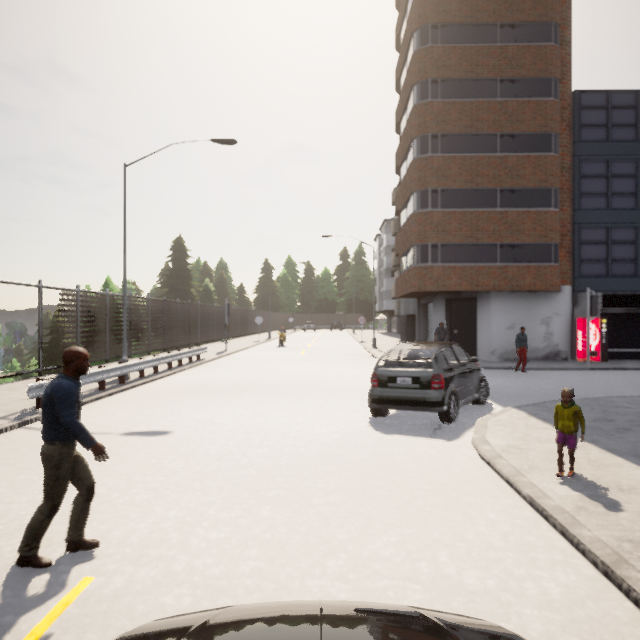

In [29]:
import torchvision
from PIL import Image

test_data_root_dir = 'test_data/attention_t01_route00_clearnoon'
source_img = Image.open(os.path.join(os.getcwd(), test_data_root_dir, 'rgb_central000517.png'))
print(source_img.size)
display(source_img)

In [30]:
def open_image(img_name: str) -> Image.Image:
    img = Image.open(os.path.join(os.getcwd(), test_data_root_dir, img_name))
    if 'virtual_attention' in img_name:
        return img.convert('L')
    return img.convert('RGB')

In [31]:
# load the data 
from dataloaders.transforms import canbus_normalization, train_transform

img_paths_dict = {
    'rgb_central': [open_image('rgb_central000517.png')],
    'rgb_left': [open_image('rgb_left000517.png')],
    'rgb_right': [open_image('rgb_right000517.png')],
    'virtual_attention_central_': [open_image('virtual_attention_central_000517.jpg')],
    'virtual_attention_left_': [open_image('virtual_attention_left_000517.jpg')],
    'virtual_attention_right_': [open_image('virtual_attention_right_000517.jpg')],
}

canbus_paths = [os.path.join(os.getcwd(), test_data_root_dir, 'cmd_fix_can_bus000517.json')]

full_dataset = []

for camera_type, img_paths in img_paths_dict.items():
    if len(img_paths) != len(canbus_paths):
        print(camera_type, len(img_paths), len(canbus_paths))
        raise RuntimeError('The numbers of images and canbus data are not mathced!!')

for i in range(len(canbus_paths)):
    datapoint = {}
    datapoint['can_bus'] = dict()
    f = open(canbus_paths[i], 'r')
    canbus_data = json.loads(f.read())
    for value in g_conf.TARGETS + g_conf.OTHER_INPUTS:
        datapoint['can_bus'][value] = canbus_data[value]
    datapoint['can_bus'] = canbus_normalization(datapoint['can_bus'], g_conf.DATA_NORMALIZATION)
    for camera_type, img_paths in img_paths_dict.items():
        datapoint[camera_type] = img_paths[i]
    full_dataset.append(datapoint)

In [32]:
full_dataset

[{'can_bus': {'steer': 0.015944600105285645,
   'acceleration': -1.0,
   'speed': 0.2654518461395478,
   'direction': [0, 0, 0, 1]},
  'rgb_central': <PIL.Image.Image image mode=RGB size=640x640 at 0x7F060D3598D0>,
  'rgb_left': <PIL.Image.Image image mode=RGB size=640x640 at 0x7F0612D704D0>,
  'rgb_right': <PIL.Image.Image image mode=RGB size=640x640 at 0x7F060D322610>,
  'virtual_attention_central_': <PIL.Image.Image image mode=L size=640x640 at 0x7F0611BB6F10>,
  'virtual_attention_left_': <PIL.Image.Image image mode=L size=640x640 at 0x7F0612D8BAD0>,
  'virtual_attention_right_': <PIL.Image.Image image mode=L size=640x640 at 0x7F0612D8B550>}]

In [33]:
data = train_transform(full_dataset[0], (3, 300, 300))

In [34]:
data

{'can_bus': {'steer': 0.015944600105285645,
  'acceleration': -1.0,
  'speed': 0.2654518461395478,
  'direction': [0, 0, 0, 1]},
 'rgb_central': tensor([[[ 1.6667,  1.6838,  1.6838,  ...,  1.6838,  1.6667,  1.6667],
          [ 1.6838,  1.6838,  1.6838,  ...,  1.6838,  1.6838,  1.6667],
          [ 1.6667,  1.6838,  1.6838,  ...,  1.6838,  1.6838,  1.6667],
          ...,
          [-0.0972,  0.0227,  0.6049,  ...,  1.6495,  1.6838,  1.6838],
          [-0.0287,  0.5022,  1.2385,  ...,  1.6667,  1.6495,  1.6324],
          [ 0.2111,  0.8789,  1.4954,  ...,  1.6838,  1.6667,  1.6495]],
 
         [[ 1.7458,  1.7633,  1.7633,  ...,  1.7633,  1.7458,  1.7458],
          [ 1.7458,  1.7633,  1.7633,  ...,  1.7633,  1.7458,  1.7458],
          [ 1.7458,  1.7633,  1.7633,  ...,  1.7633,  1.7458,  1.7458],
          ...,
          [ 0.0301,  0.1001,  0.6254,  ...,  1.6583,  1.6758,  1.6933],
          [ 0.0826,  0.5378,  1.2381,  ...,  1.6583,  1.6408,  1.6408],
          [ 0.2752,  0.8880,  1

## Forward

In [35]:
from einops import rearrange

src_images = [data[camera_type] for camera_type in g_conf.DATA_USED if 'rgb' in camera_type]
src_directions = [torch.tensor([data['can_bus']['direction']]).float()]
src_s = [torch.tensor([data['can_bus']['speed']]).float()]

In [36]:
torch.stack(src_images).shape

torch.Size([3, 3, 300, 300])

In [37]:
x = torch.stack(src_images)
d = src_directions[-1]
s = src_s[-1]

In [38]:
e_p, resnet_inter = model.encoder_embedding_perception(x)

In [39]:
for i in resnet_inter:
    print(i.shape)

torch.Size([3, 64, 150, 150])
torch.Size([3, 64, 75, 75])
torch.Size([3, 128, 38, 38])
torch.Size([3, 256, 19, 19])
torch.Size([3, 512, 10, 10])


In [40]:
e_p = rearrange(e_p, 'b dim h w -> 1 (b h w) dim')

e_d = model.command(d).unsqueeze(1)
e_s = model.speed(s).unsqueeze(0).unsqueeze(0)

e_p = e_p + e_d + e_s
e_p = e_p + model.positional_encoding

in_memory, attn_weights = model.tx_encoder(e_p)

In [41]:
attn_weights[0].shape

torch.Size([1, 300, 300])

In [42]:
model.action_prediction(in_memory, 3)

(tensor([[[ 0.0166, -0.7345]]], grad_fn=<UnsqueezeBackward0>), None, None)

### Let's get down to business ...

Let's visualize the features of the ResNet and all the layers of the Transformer Encoder:

In [43]:
resnet_inter[0].shape

torch.Size([3, 64, 150, 150])

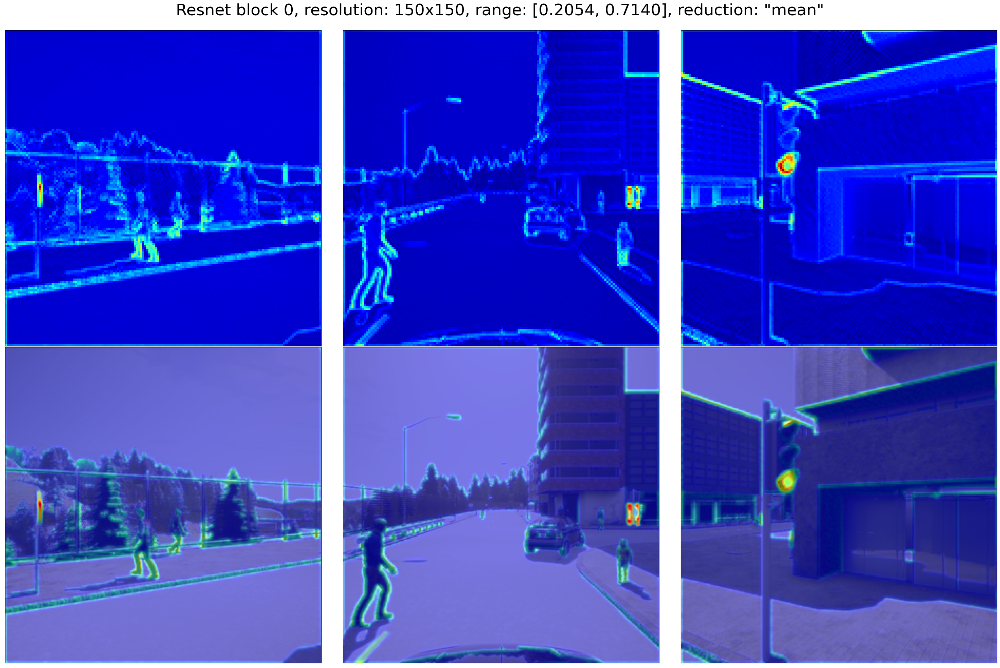

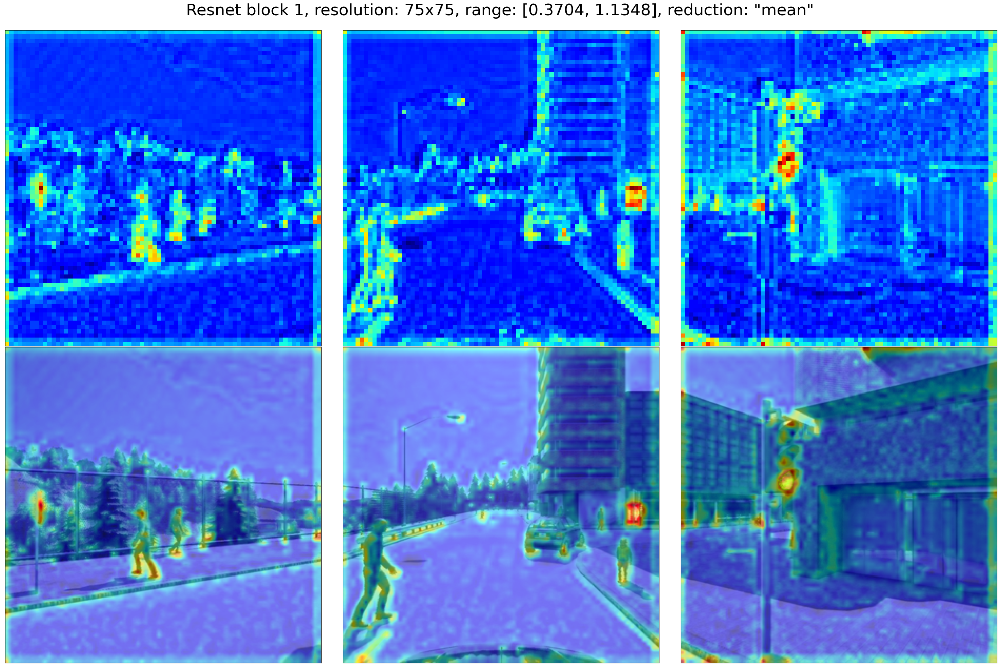

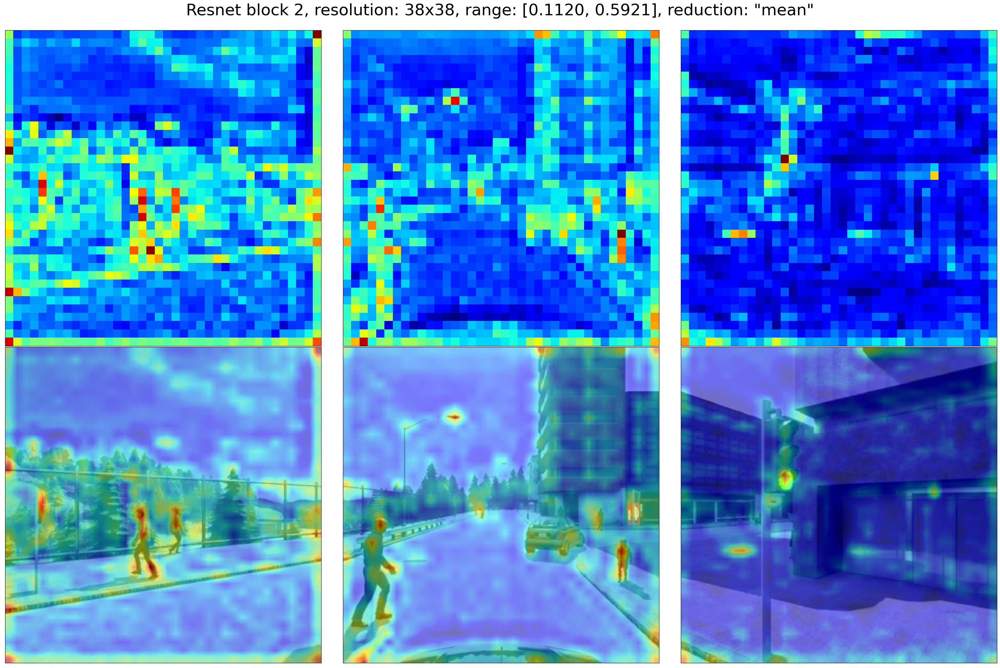

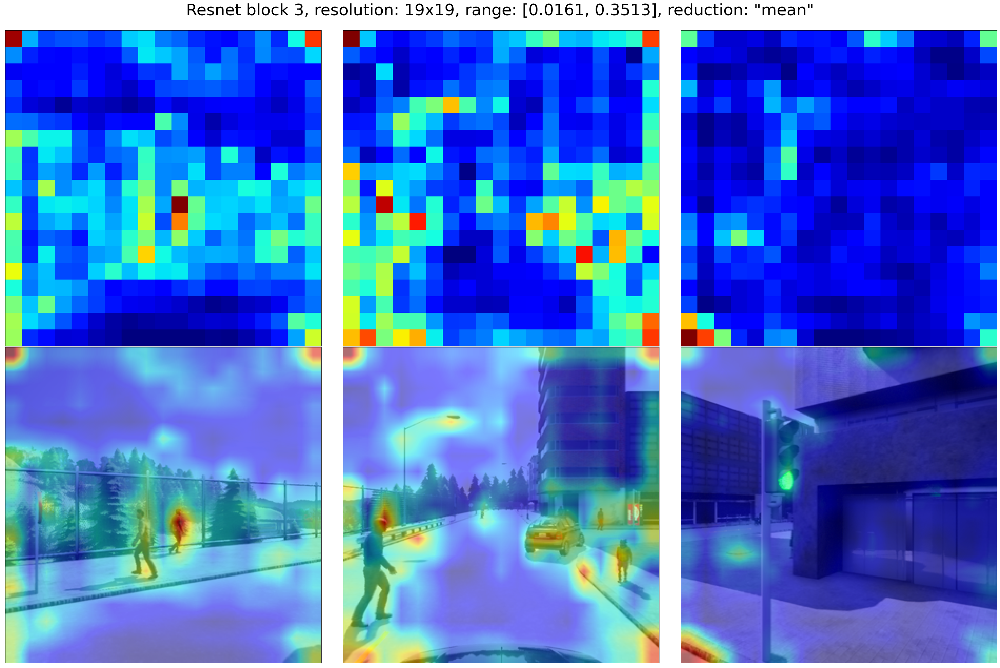

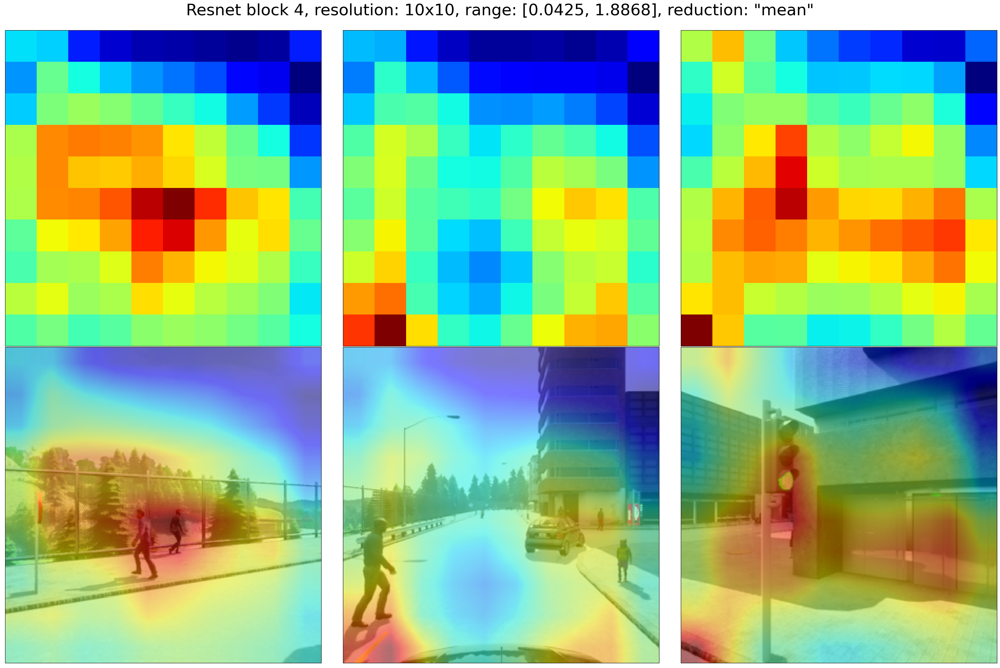

In [44]:
import matplotlib.pyplot as plt
import torchvision.transforms.functional as TF
from einops import reduce
import cv2

reduction = 'mean'

for idx, res in enumerate(resnet_inter):
    num_cameras = res.shape[0]
    # Average over the channels (dim=1)
    res = reduce(res, 'cam dim h w -> cam h w', reduction)
    
    # Plot the three cameras side by side
    fig, ax = plt.subplots(2, num_cameras, figsize=(10 * num_cameras, 20))
    fig.suptitle(f'Resnet block {idx}, resolution: {res.shape[-1]}x{res.shape[-1]}, range: [{res.min().item():.4f}, {res.max().item():.4f}], reduction: "{reduction}"', fontsize=34)

    for cam in range(num_cameras):
        ax[0, cam].imshow(res.detach().numpy()[cam], cmap='jet')
        ax[0, cam].set_xticks([])
        ax[0, cam].set_yticks([])

        img = src_images[cam]
        img = TF.normalize(img, [-0.485/0.229, -0.456/0.224, -0.406/0.255], [1/0.229, 1/0.224, 1/0.255])
        img = torch.clamp(img, 0, 1)

        res_up = cv2.resize(res.detach().numpy()[cam], (img.size(1), img.size(2)), interpolation=cv2.INTER_LINEAR)
        # res_up = TF.resize(res[cam], img.size(-1), antialias=True)
        ax[1, cam].imshow(img.detach().numpy().transpose(1, 2, 0))
        ax[1, cam].imshow(res_up, cmap='jet', alpha=0.5)
        ax[1, cam].set_xticks([])
        ax[1, cam].set_yticks([])


    fig.tight_layout()
    fig.subplots_adjust(top=0.94)
    plt.show()

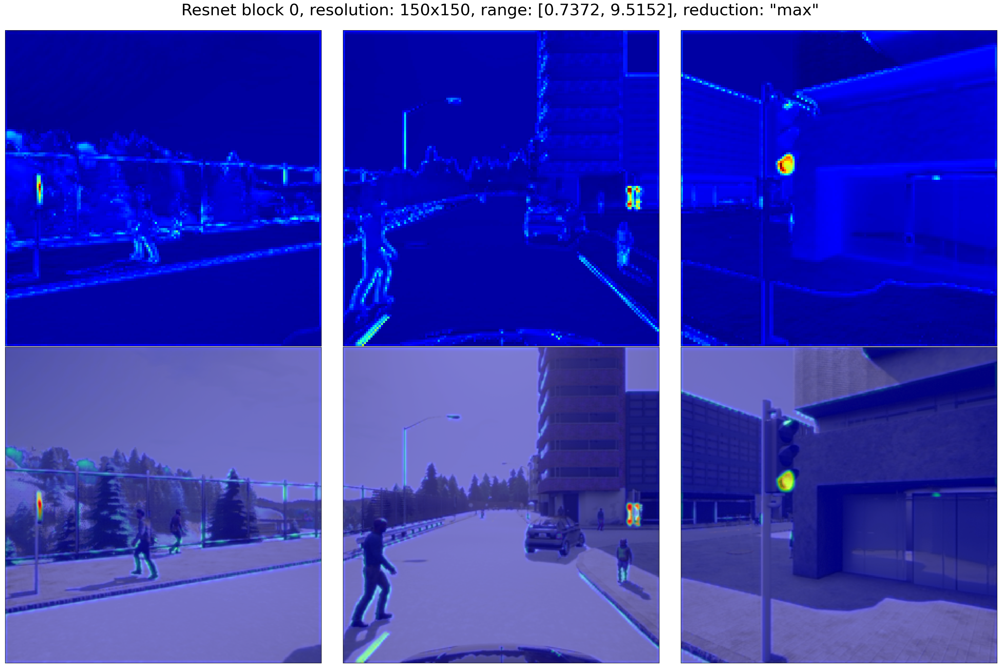

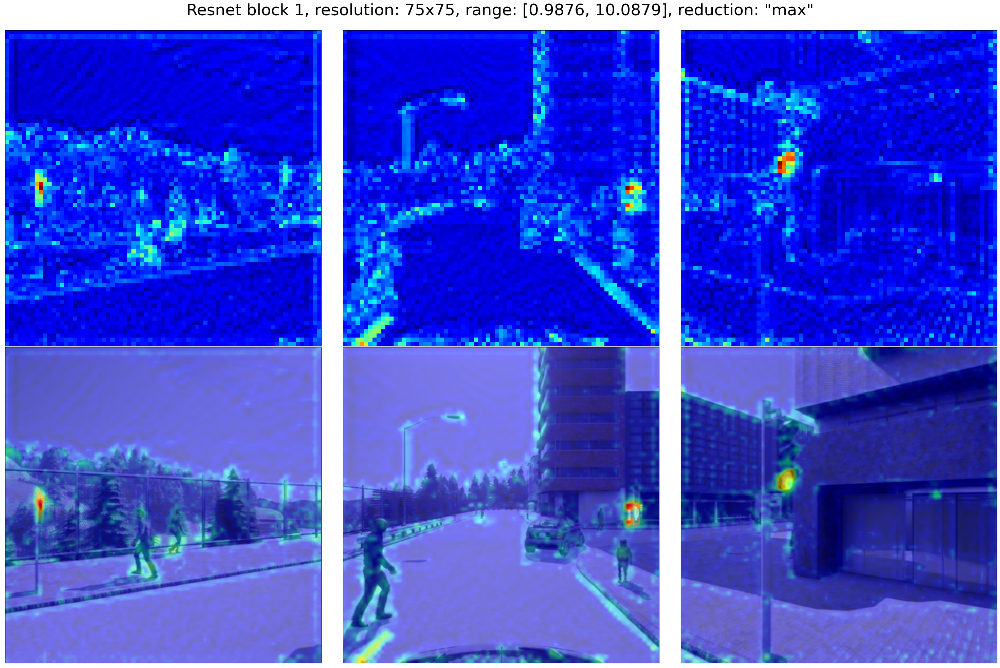

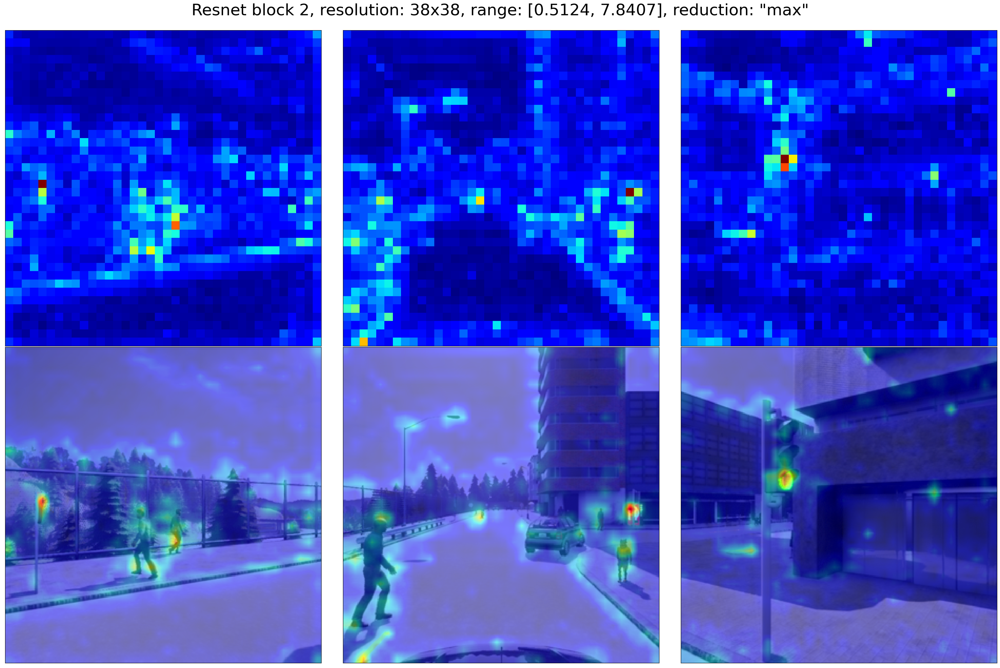

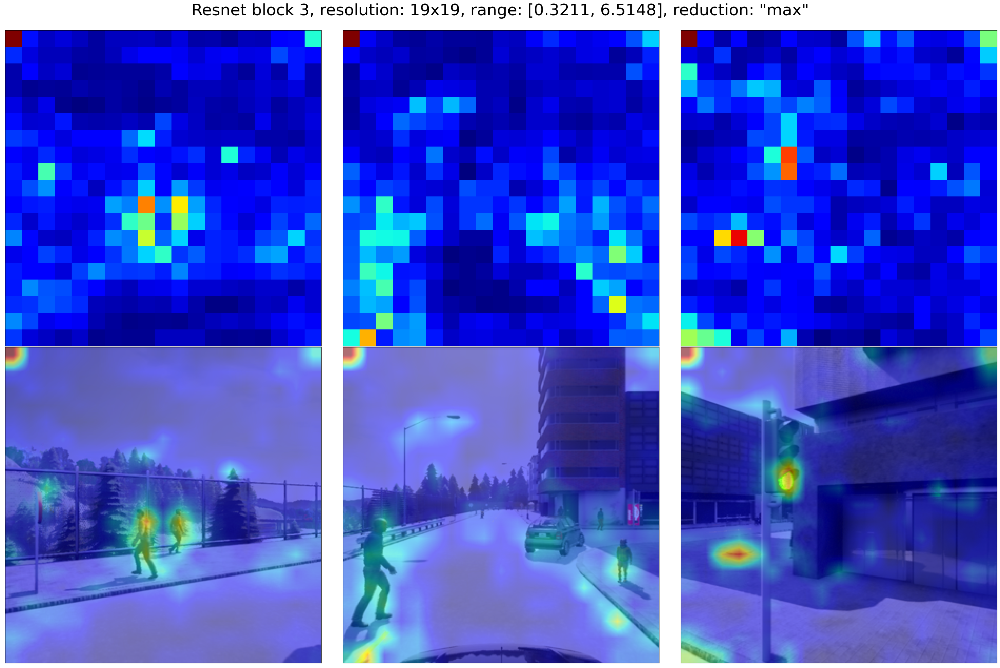

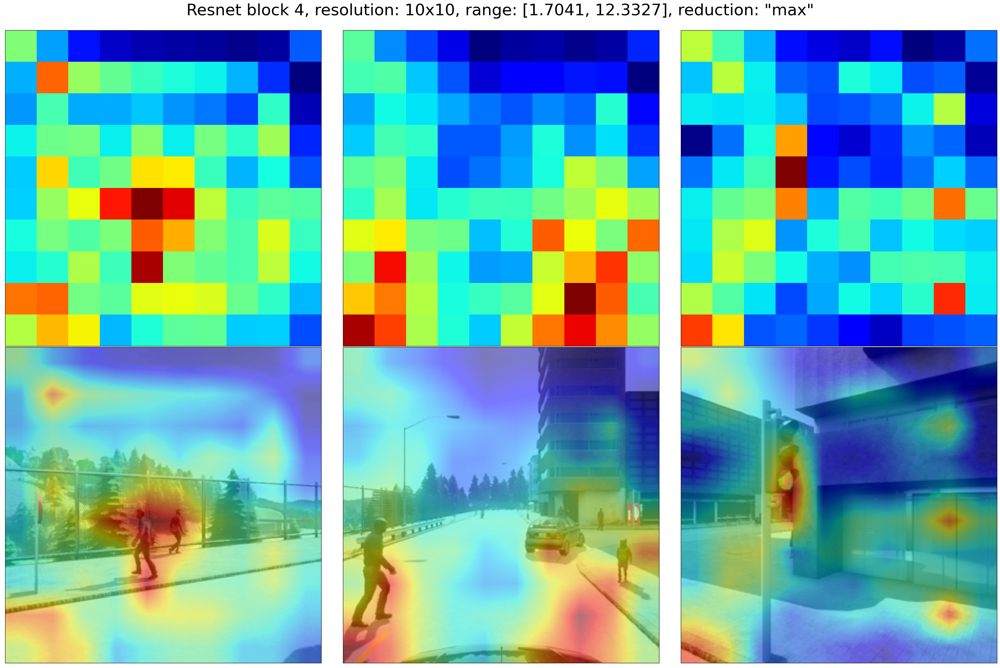

In [45]:
reduction = 'max'

for idx, res in enumerate(resnet_inter):
    num_cameras = res.shape[0]
    # Average over the channels (dim=1)
    res = reduce(res, 'cam dim h w -> cam h w', reduction)
    
    # Plot the three cameras side by side
    fig, ax = plt.subplots(2, num_cameras, figsize=(10 * num_cameras, 20))
    fig.suptitle(f'Resnet block {idx}, resolution: {res.shape[-1]}x{res.shape[-1]}, range: [{res.min().item():.4f}, {res.max().item():.4f}], reduction: "{reduction}"', fontsize=34)

    for cam in range(num_cameras):
        ax[0, cam].imshow(res.detach().numpy()[cam], cmap='jet')
        ax[0, cam].set_xticks([])
        ax[0, cam].set_yticks([])

        img = src_images[cam]
        img = TF.normalize(img, [-0.485/0.229, -0.456/0.224, -0.406/0.255], [1/0.229, 1/0.224, 1/0.255])
        img = torch.clamp(img, 0, 1)

        res_up = cv2.resize(res.detach().numpy()[cam], (img.size(1), img.size(2)), interpolation=cv2.INTER_LINEAR)
        ax[1, cam].imshow(img.detach().numpy().transpose(1, 2, 0))
        ax[1, cam].imshow(res_up, cmap='jet', alpha=0.5)
        ax[1, cam].set_xticks([])
        ax[1, cam].set_yticks([])


    fig.tight_layout()
    fig.subplots_adjust(top=0.94)
    plt.show()

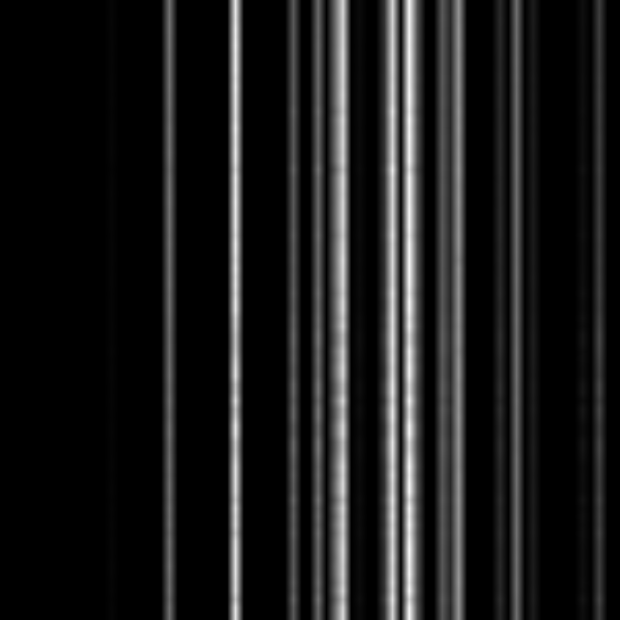

In [46]:
import numpy as np
t = attn_weights[-1][0].detach().cpu().numpy()
t = cv2.resize(t, (75, 75), cv2.INTER_LINEAR)
t = (t - t.min()) / (t.max() - t.min())
# Set values to zero when they are below 0.5
t = cv2.resize(t, (620, 620), cv2.INTER_AREA)
t = (255 * t).astype(np.uint8)
Image.fromarray(t)

In [47]:
import numpy as np
t = attn_weights[-1][0].detach().cpu().numpy()
t = cv2.resize(t, (75, 75), cv2.INTER_NEAREST)
t = (t - t.min()) / (t.max() - t.min())
t = reduce(t, 'h w -> w', 'mean')[None, :]
# t = cv2.resize(t, (620, 124), cv2.INTER_AREA)
t = (255 * t).astype(np.uint8)
Image.fromarray(t)

In [48]:
t2 = attn_weights[-1].detach().cpu()
t2 = reduce(t2, 'cam h w -> cam w', 'mean')
t2 = (t2 - t2.min()) / (t2.max() - t2.min())
t2 = (255 * t2).numpy().astype(np.uint8)
cv2.resize(t2, ())
Image.fromarray(t2)

TypeError: function takes exactly 2 arguments (0 given)

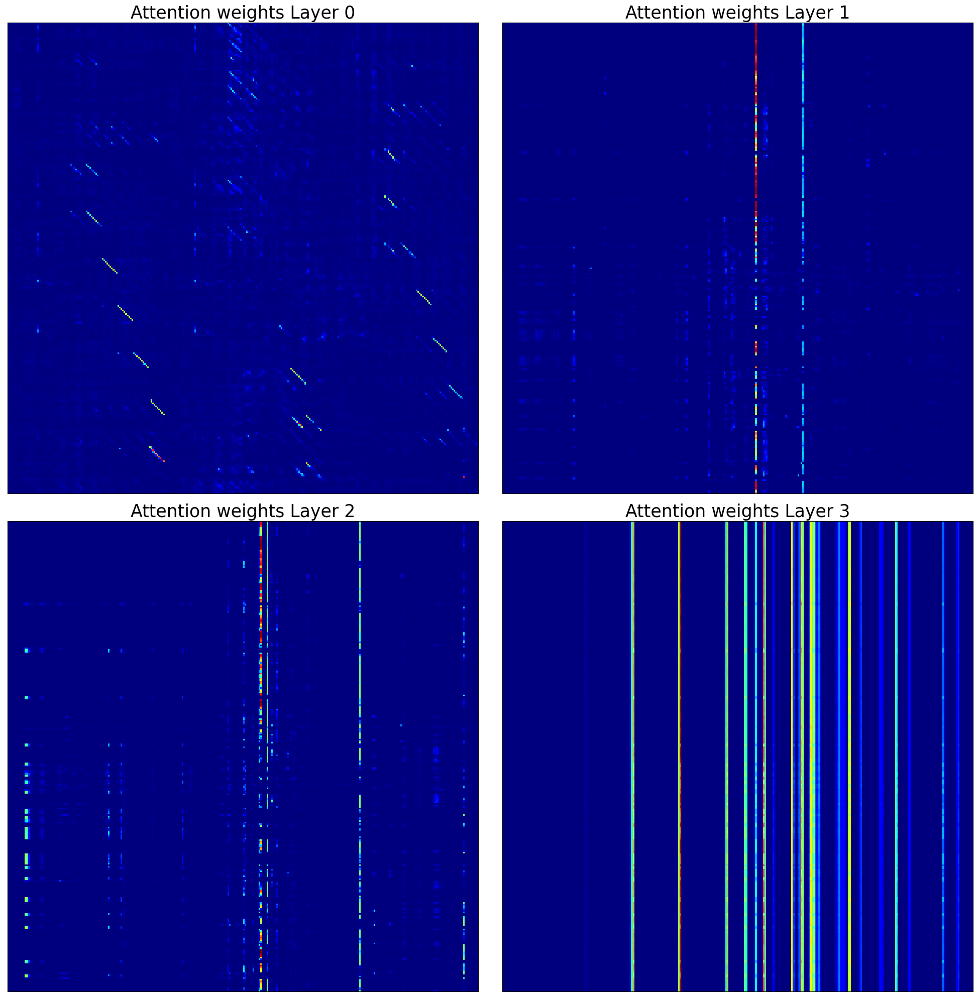

In [ ]:
# attn_weights is a list of 4 elements, each a tensor of shape (1, 300, 300)
# Let's plot them
fig, ax = plt.subplots(2, 2, figsize=(20, 20))
for idx, attn in enumerate(attn_weights):
    # Set title
    ax[idx // 2, idx % 2].set_title(f'Attention weights Layer {idx}', fontsize=25)
    ax[idx // 2, idx % 2].imshow(attn.squeeze().detach().numpy(), cmap='jet')
    ax[idx // 2, idx % 2].set_xticks([])
    ax[idx // 2, idx % 2].set_yticks([])

    fig.tight_layout()
    # fig.subplots_adjust(top=0.94)
plt.show()

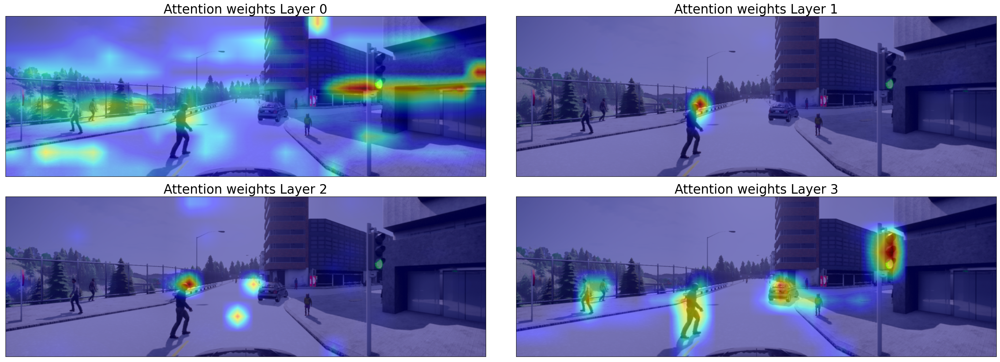

In [ ]:
# Let's show them on top of the images
# First, concatenate horizontally the left, central, and right camera images
img_cat = torch.cat(src_images, dim=2)
img_cat = TF.normalize(img_cat, [-0.485/0.229, -0.456/0.224, -0.406/0.255], [1/0.229, 1/0.224, 1/0.255])
img_cat = torch.clamp(img_cat, 0, 1)
img_cat = img_cat.cpu().numpy().transpose(1, 2, 0)

fig, ax = plt.subplots(2, 2, figsize=(30, 10))
for idx, attn in enumerate(attn_weights):
    # Set title
    ax[idx // 2, idx % 2].set_title(f'Attention weights Layer {idx}', fontsize=25)
    ax[idx // 2, idx % 2].imshow(img_cat)
    # Plot attention weights
    attn = attn.squeeze().mean(0).view(10, 30).detach().numpy()
    attn = cv2.resize(attn, (img_cat.shape[1], img_cat.shape[0]), interpolation=cv2.INTER_LINEAR)
    ax[idx // 2, idx % 2].imshow(attn, cmap='jet', alpha=0.5)
    ax[idx // 2, idx % 2].set_xticks([])
    ax[idx // 2, idx % 2].set_yticks([])

    fig.tight_layout()
    # fig.subplots_adjust(top=0.94)
plt.show()

## Now for the no-attention model

In [55]:
import warnings
warnings.simplefilter(action='ignore', category=FutureWarning)

from network.models.architectures.CIL_multiview.CIL_multiview import CIL_multiview
import os
import json
from configs import g_conf, set_type_of_process, merge_with_yaml
from _utils.training_utils import check_saved_checkpoints
import torch
from typing import OrderedDict


os.environ["CUDA_VISIBLE_DEVICES"] = "5"

exp_batch = 'CILv2_attention'
exp_name = 'CILv2_3cam_Town01_8hdata_noAttention'

merge_with_yaml(os.path.join('configs', exp_batch, f'{exp_name}.yaml'))
g_conf.PROCESS_NAME = 'train_val'
g_conf.DATASET_PATH = '/datafast/Datasets/dporres/CARLA'

os.environ['DATASET_PATH'] = g_conf.DATASET_PATH

model = CIL_multiview(g_conf.MODEL_CONFIGURATION)



latest_checkpoint = check_saved_checkpoints(
    os.path.join('/datafast/experiments/dporres/VisionTFM/',
                 '_results', g_conf.EXPERIMENT_BATCH_NAME, g_conf.EXPERIMENT_NAME, 'checkpoints'))

checkpoint = torch.load(latest_checkpoint)

new_state_dict = {}
for k, v in checkpoint['model'].items():
    new_state_dict[k[7:]] = v


new_state_dict = OrderedDict(new_state_dict)

model.load_state_dict(new_state_dict)

e_p, resnet_inter = model.encoder_embedding_perception(x)

e_p = rearrange(e_p, 'b dim h w -> 1 (b h w) dim')

e_d = model.command(d).unsqueeze(1)
e_s = model.speed(s).unsqueeze(0).unsqueeze(0)

e_p = e_p + e_d + e_s
e_p = e_p + model.positional_encoding

in_memory, attn_weights = model.tx_encoder(e_p)

print(model.action_prediction(in_memory, 3))

(tensor([[[-0.0112, -0.4021]]], grad_fn=<UnsqueezeBackward0>), None, None)


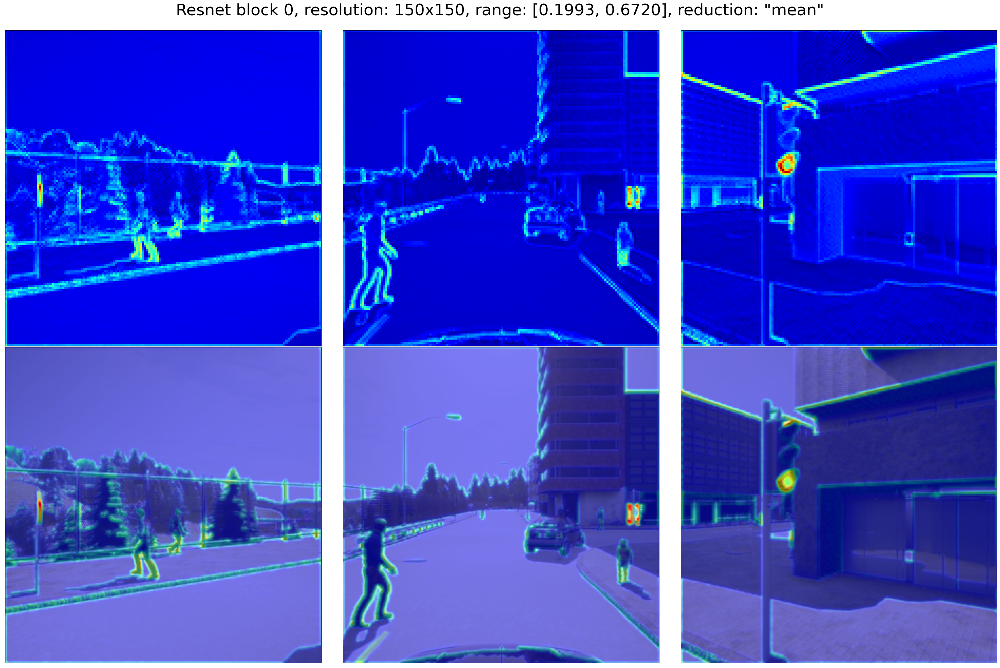

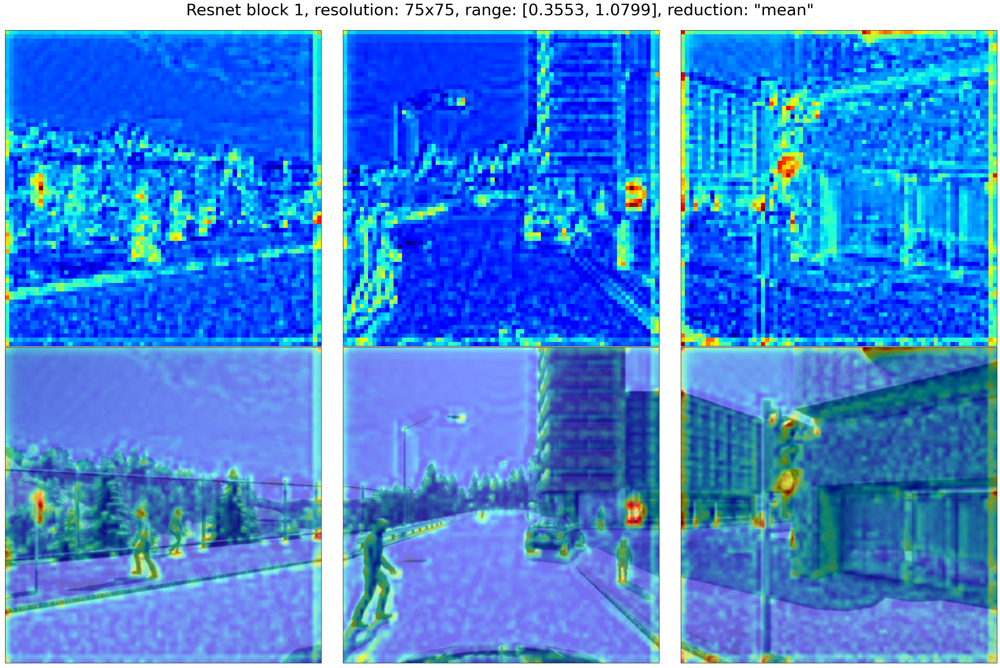

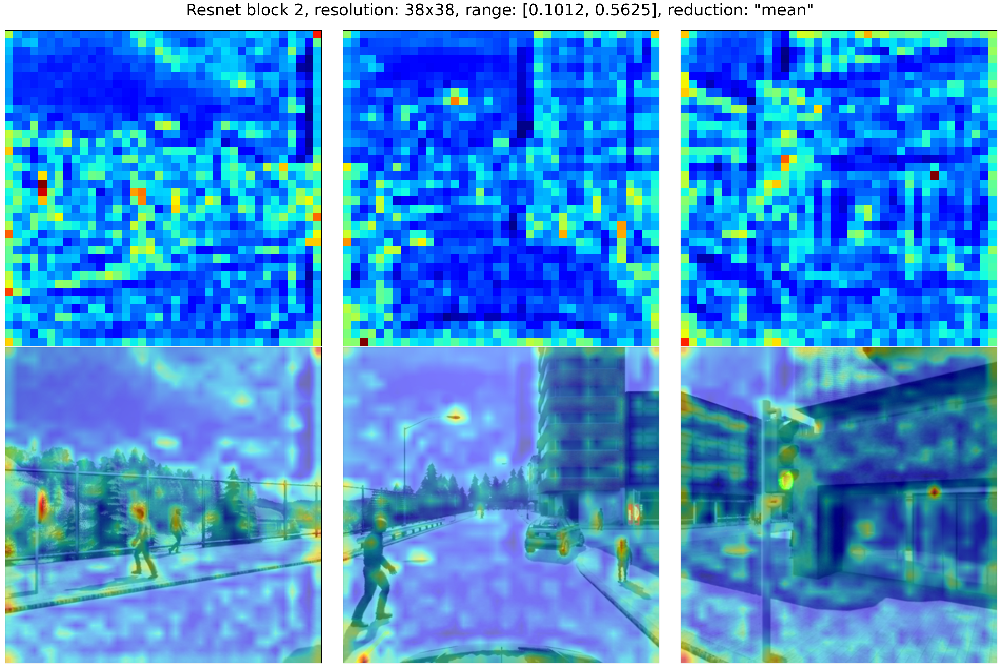

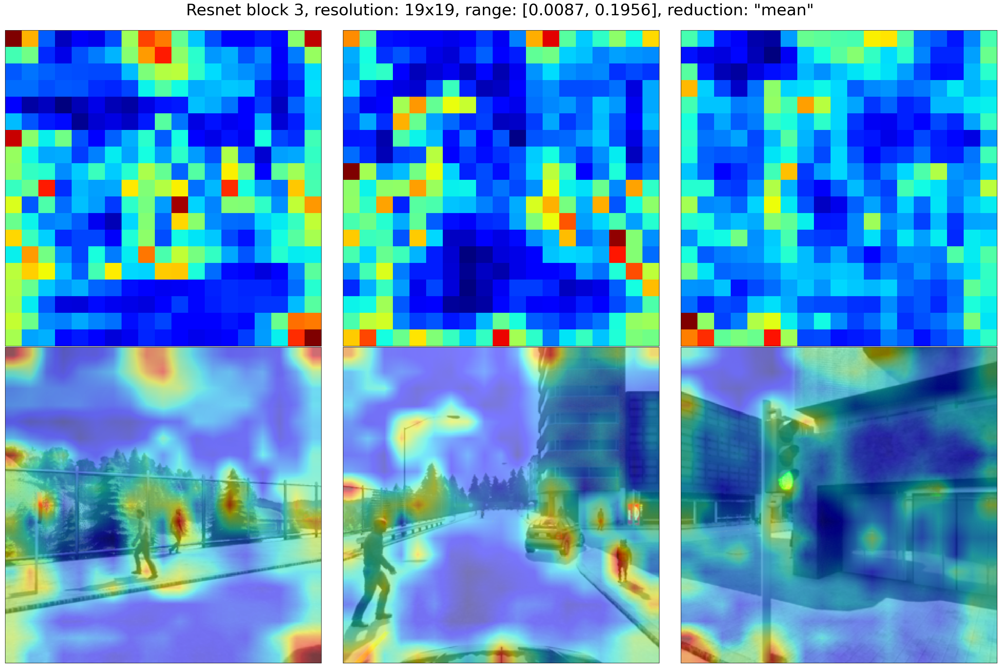

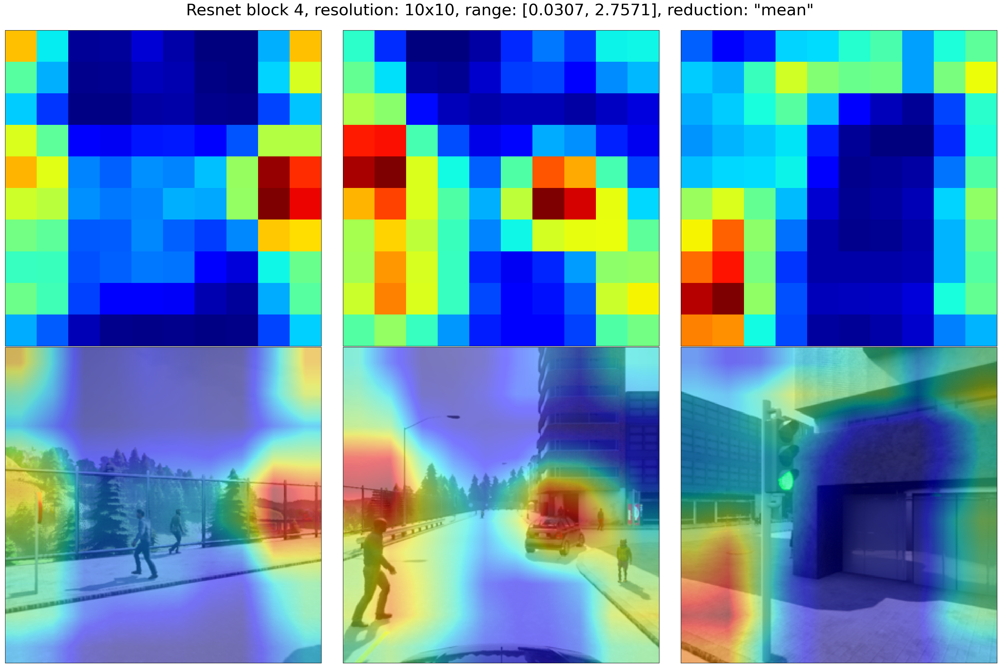

In [56]:
import matplotlib.pyplot as plt
import torchvision.transforms.functional as TF
from einops import reduce, rearrange
import cv2

reduction = 'mean'

for idx, res in enumerate(resnet_inter):
    num_cameras = res.shape[0]
    # Average over the channels (dim=1)
    res = reduce(res, 'cam dim h w -> cam h w', reduction)
    
    # Plot the three cameras side by side
    fig, ax = plt.subplots(2, num_cameras, figsize=(10 * num_cameras, 20))
    fig.suptitle(f'Resnet block {idx}, resolution: {res.shape[-1]}x{res.shape[-1]}, range: [{res.min().item():.4f}, {res.max().item():.4f}], reduction: "{reduction}"', fontsize=34)

    for cam in range(num_cameras):
        ax[0, cam].imshow(res.detach().numpy()[cam], cmap='jet')
        ax[0, cam].set_xticks([])
        ax[0, cam].set_yticks([])

        img = src_images[cam]
        img = TF.normalize(img, [-0.485/0.229, -0.456/0.224, -0.406/0.255], [1/0.229, 1/0.224, 1/0.255])
        img = torch.clamp(img, 0, 1)

        res_up = cv2.resize(res.detach().numpy()[cam], (img.size(1), img.size(2)), interpolation=cv2.INTER_LINEAR)
        # res_up = TF.resize(res[cam], img.size(-1), antialias=True)
        ax[1, cam].imshow(img.detach().numpy().transpose(1, 2, 0))
        ax[1, cam].imshow(res_up, cmap='jet', alpha=0.5)
        ax[1, cam].set_xticks([])
        ax[1, cam].set_yticks([])


    fig.tight_layout()
    fig.subplots_adjust(top=0.94)
    plt.show()

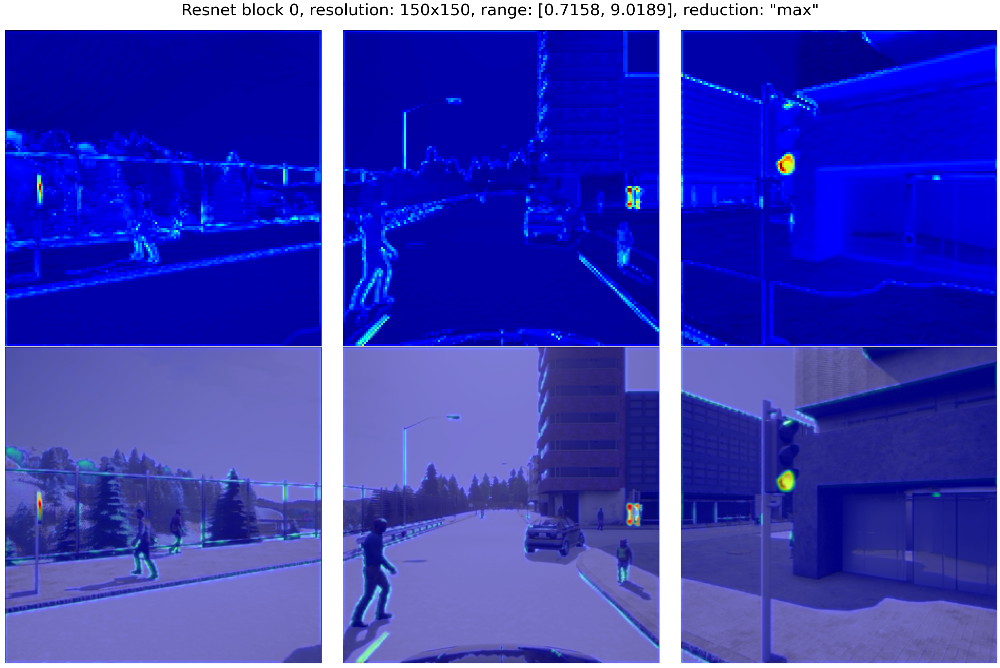

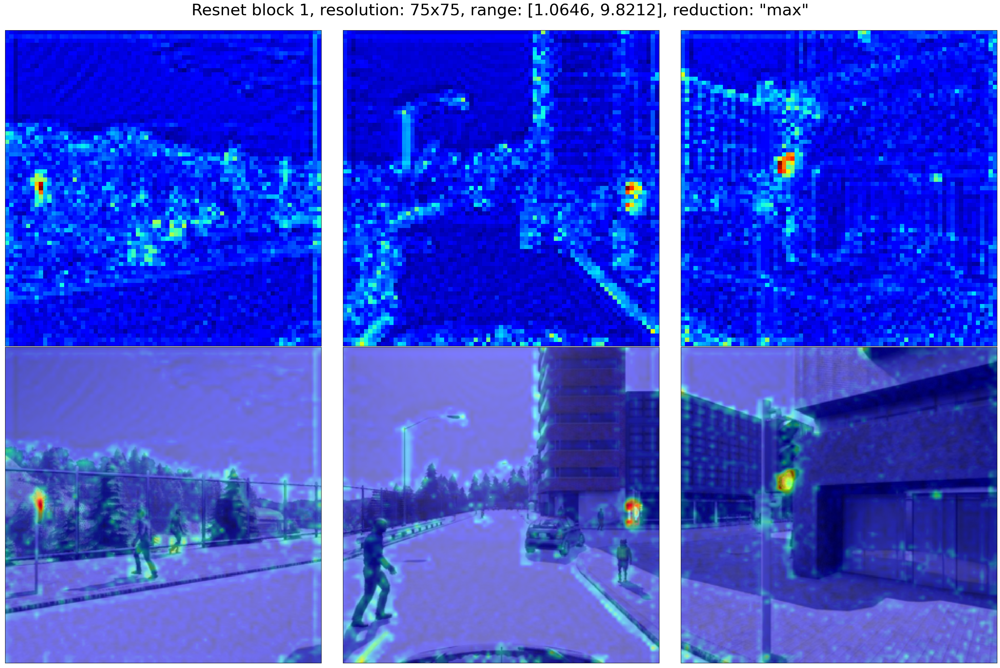

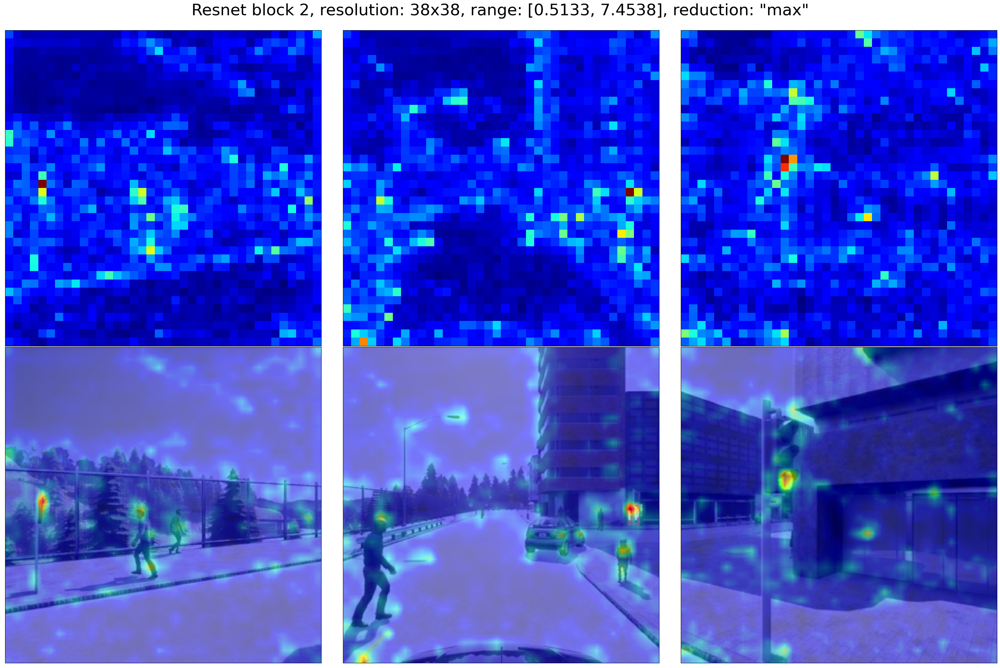

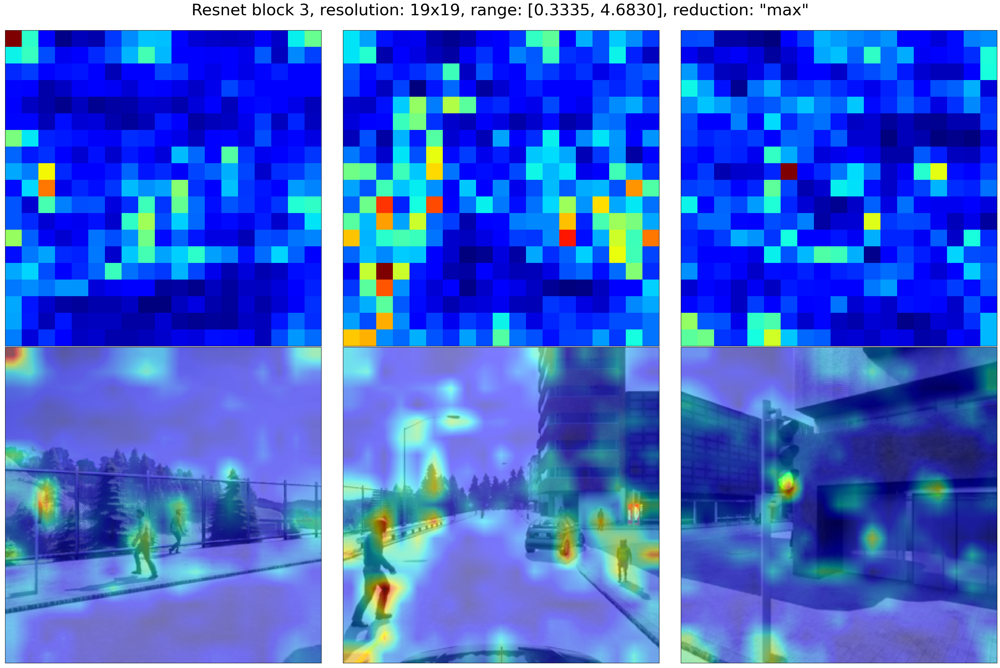

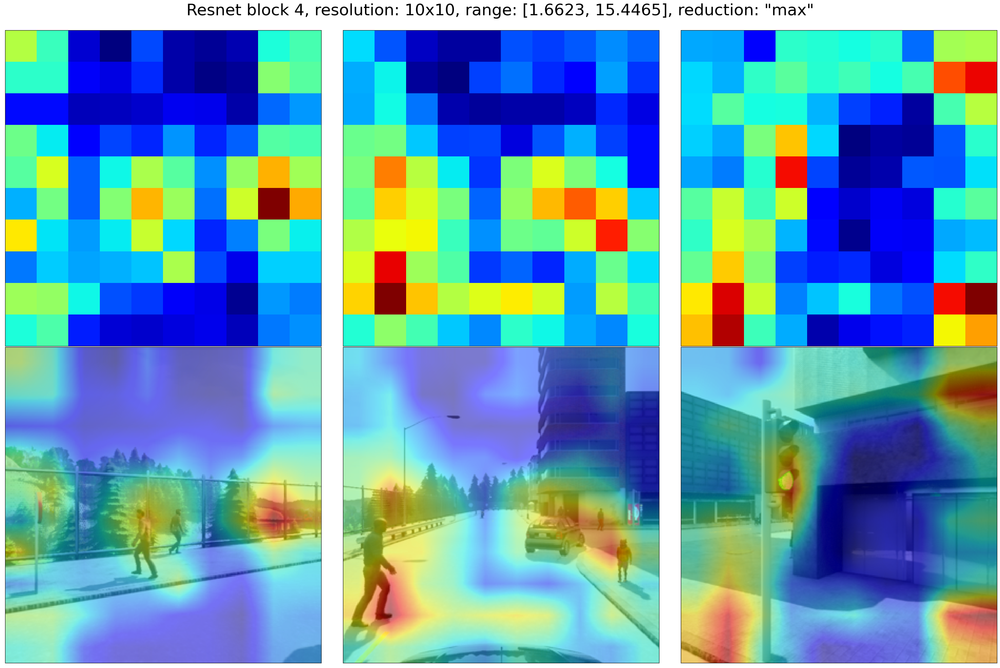

In [57]:
reduction = 'max'

for idx, res in enumerate(resnet_inter):
    num_cameras = res.shape[0]
    # Average over the channels (dim=1)
    res = reduce(res, 'cam dim h w -> cam h w', reduction)
    
    # Plot the three cameras side by side
    fig, ax = plt.subplots(2, num_cameras, figsize=(10 * num_cameras, 20))
    fig.suptitle(f'Resnet block {idx}, resolution: {res.shape[-1]}x{res.shape[-1]}, range: [{res.min().item():.4f}, {res.max().item():.4f}], reduction: "{reduction}"', fontsize=34)

    for cam in range(num_cameras):
        ax[0, cam].imshow(res.detach().numpy()[cam], cmap='jet')
        ax[0, cam].set_xticks([])
        ax[0, cam].set_yticks([])

        img = src_images[cam]
        img = TF.normalize(img, [-0.485/0.229, -0.456/0.224, -0.406/0.255], [1/0.229, 1/0.224, 1/0.255])
        img = torch.clamp(img, 0, 1)

        res_up = cv2.resize(res.detach().numpy()[cam], (img.size(1), img.size(2)), interpolation=cv2.INTER_LINEAR)
        # res_up = TF.resize(res[cam], img.size(-1), antialias=True)
        ax[1, cam].imshow(img.detach().numpy().transpose(1, 2, 0))
        ax[1, cam].imshow(res_up, cmap='jet', alpha=0.5)
        ax[1, cam].set_xticks([])
        ax[1, cam].set_yticks([])


    fig.tight_layout()
    fig.subplots_adjust(top=0.94)
    plt.show()

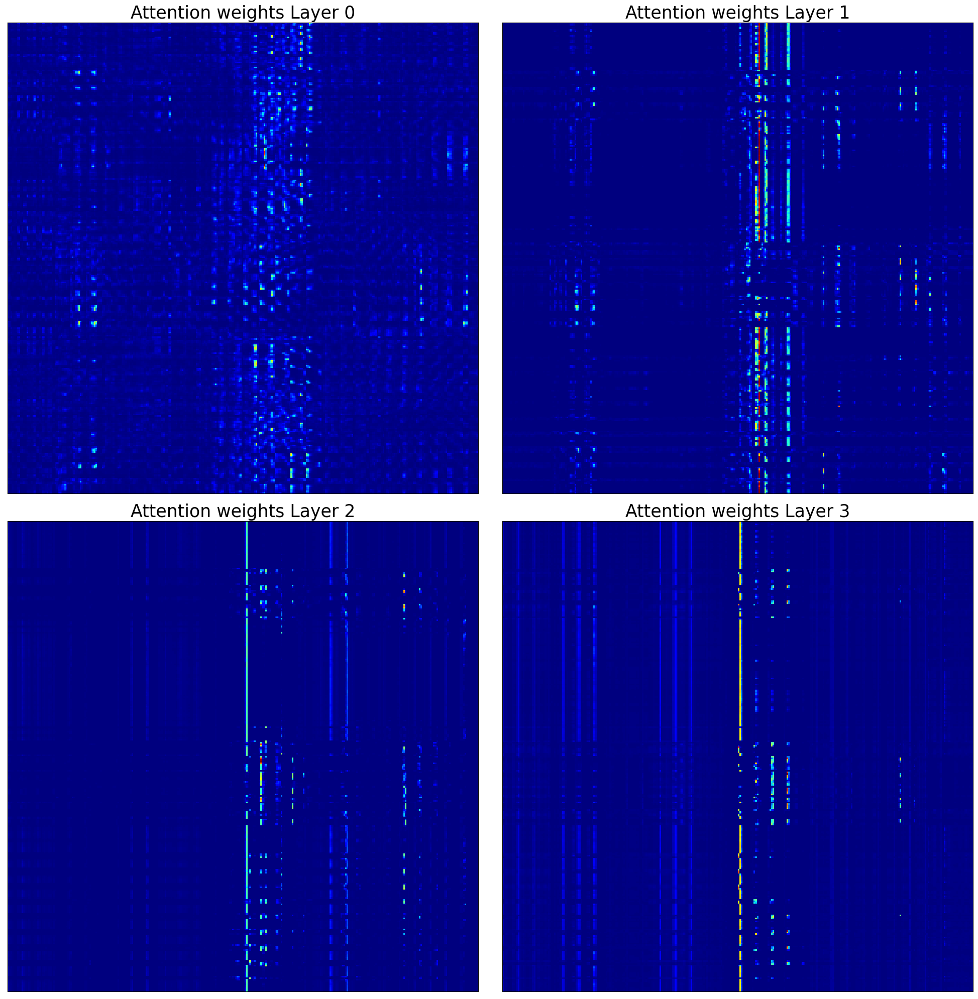

In [58]:
# attn_weights is a list of 4 elements, each a tensor of shape (1, 300, 300)
# Let's plot them
fig, ax = plt.subplots(2, 2, figsize=(20, 20))
for idx, attn in enumerate(attn_weights):
    # Set title
    ax[idx // 2, idx % 2].set_title(f'Attention weights Layer {idx}', fontsize=25)
    ax[idx // 2, idx % 2].imshow(attn.squeeze().detach().numpy(), cmap='jet')
    ax[idx // 2, idx % 2].set_xticks([])
    ax[idx // 2, idx % 2].set_yticks([])

    fig.tight_layout()
    # fig.subplots_adjust(top=0.94)
plt.show()

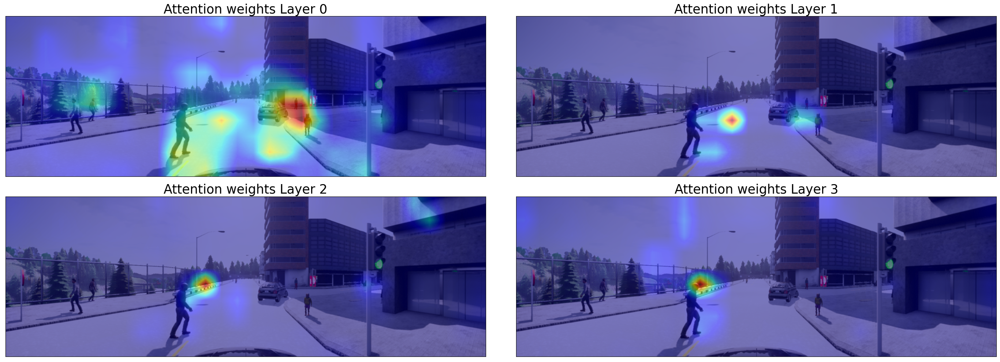

In [59]:
# Let's show them on top of the images
# First, concatenate horizontally the left, central, and right camera images
from _utils import utils
import torchvision.transforms.functional as TF
import matplotlib.pyplot as plt
import cv2

img_cat = torch.cat(src_images, dim=2)
img_cat = TF.normalize(img_cat, [-0.485/0.229, -0.456/0.224, -0.406/0.255], [1/0.229, 1/0.224, 1/0.255])
img_cat = torch.clamp(img_cat, 0, 1)
img_cat = img_cat.cpu().numpy().transpose(1, 2, 0)

fig, ax = plt.subplots(2, 2, figsize=(30, 10))
for idx, attn in enumerate(attn_weights):
    # Set title
    ax[idx // 2, idx % 2].set_title(f'Attention weights Layer {idx}', fontsize=25)
    ax[idx // 2, idx % 2].imshow(img_cat)
    # Plot attention weights
    # attn = attn.squeeze().mean(0).view(10, 30).detach().numpy()
    attn = attn.mean(dim=1)  # [B, S*cam*(H//P)^2] or [B, N]
    attn = utils.min_max_norm(attn)  # [B, S*cam*(H//P)^2] or [B, N]
    attn = rearrange(attn, 'B (h w S cam) -> B 1 h (w S cam)' if g_conf.ATTENTION_LOSS else 'B (S cam h w) -> B 1 h (S cam w)', 
                     S=1, cam=3, h=model.res_out_h)  # [B, 1, H//P, S*cam*W//P]
    attn = attn.squeeze().detach().numpy()

    attn = cv2.resize(attn, (img_cat.shape[1], img_cat.shape[0]), interpolation=cv2.INTER_LINEAR)
    ax[idx // 2, idx % 2].imshow(attn, cmap='jet', alpha=0.5)
    ax[idx // 2, idx % 2].set_xticks([])
    ax[idx // 2, idx % 2].set_yticks([])

    fig.tight_layout()
    # fig.subplots_adjust(top=0.94)
plt.show()